<a href="https://colab.research.google.com/github/RickMLS1/PDI-Lists/blob/main/Image_transformations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Before you turn this problem in, make sure everything runs as expected. First, **restart the kernel** (in the menubar, select Kernel$\rightarrow$Restart) and then **run all cells** (in the menubar, select Cell$\rightarrow$Run All).

Make sure you fill in any place that says `YOUR CODE HERE` or "YOUR ANSWER HERE", as well as your name and collaborators below:

In [ ]:
NAME = "Rick Martim Lino dos Santos"
COLLABORATORS = ""

---

In [2]:
import numpy as np
import cv2
from utils import *
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

In [1]:
!pip install utils

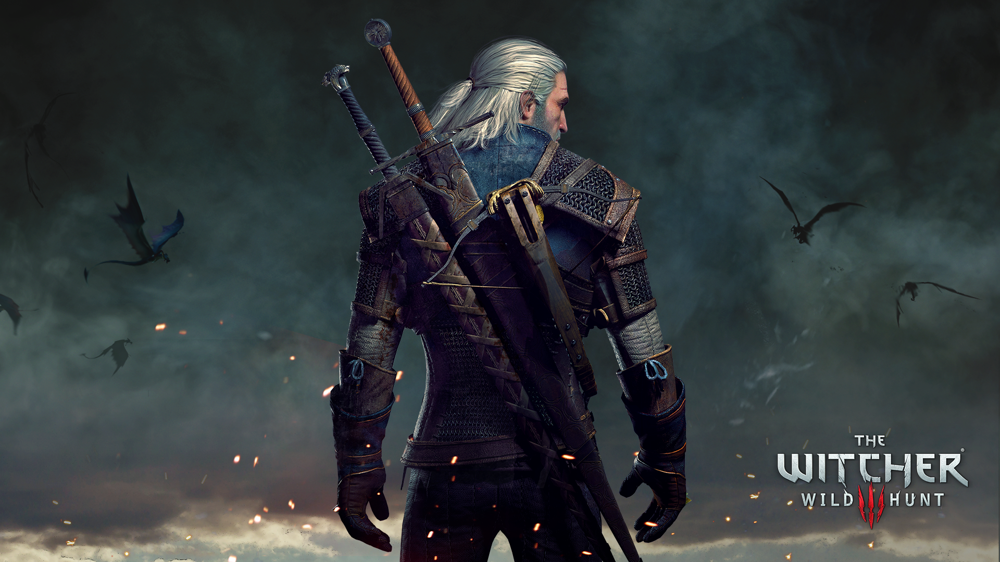

In [ ]:
pAth = 'imagens/img.png'
img = cv2.imread(pAth, cv2.IMREAD_COLOR)
cv2_imshow(img)

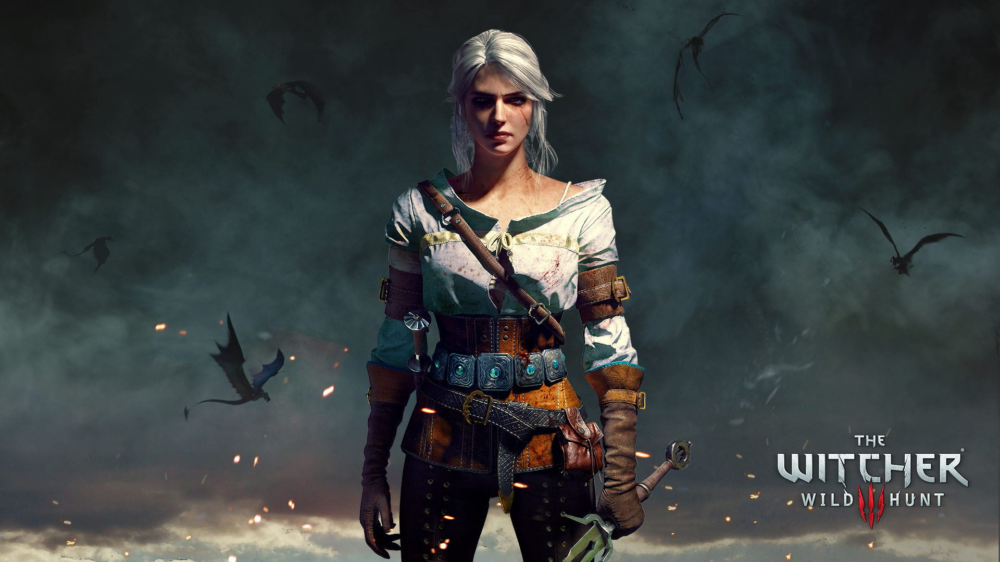

In [ ]:
pAth = 'imagens/img2.png'
img2 = cv2.imread(pAth, cv2.IMREAD_COLOR)
cv2_imshow(img2)

## Introduction

In Python, an image can be represented as a matrix or a NumPy array. Each pixel corresponds to an element in the matrix. You can manipulate the image by accessing and modifying the matrix elements using array manipulation libraries like NumPy. This allows for efficient operations such as cropping, flipping, resizing, filtering, and more. Treating an image as a matrix provides flexibility and access to a wide range of tools for image processing tasks in Python.

For more details, refer to:

[OpenCV Getting and Setting Pixels](https://pyimagesearch.com/2021/01/20/opencv-getting-and-setting-pixels/)

# Crop and flip an image using Numpy array indexing.

In [ ]:
def crop(img, x1, y1, x2, y2):
    '''
    Crop an image using NumPy array indexing.
    Parameters:
    image (numpy.ndarray): The input image as a NumPy array.
    x1 (int): The x-coordinate of the top-left corner of the cropping area.
    y1 (int): The y-coordinate of the top-left corner of the cropping area.
    x2 (int): The x-coordinate of the bottom-right corner of the cropping area.
    y2 (int): The y-coordinate of the bottom-right corner of the cropping area.

    Returns:
    numpy.ndarray: The cropped image as a NumPy array.
    '''
    # YOUR CODE HERE
    cropped_image = img[y1:y2, x1:x2]
    return cropped_image

In [ ]:
def flip(img, axis):
    '''
    Flip an image using NumPy array indexing.

    Parameters:
    image (numpy.ndarray): The input image as a NumPy array.
    axis (int): The axis along which to flip the image.
                0: Flip vertically (upside down).
                1: Flip horizontally (mirror image).

    Returns:
    numpy.ndarray: The flipped image as a NumPy array.
    '''
     # YOUR CODE HERE
    flipped_image = np.zeros_like(img)
    (h, w) = img.shape[:2]

    if axis == 0:
        for row in range(h):
            flipped_image[row, :] = img[h - row - 1, :]
    elif axis == 1:
        for column in range(w):
            flipped_image[:, column] = img[:, w - column - 1]
    return flipped_image

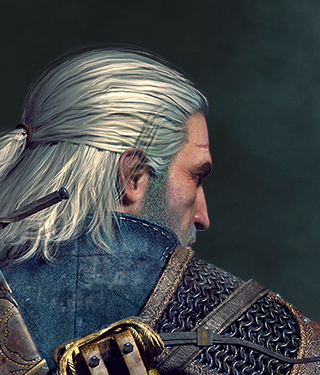

In [ ]:
cropped = crop(img, 880, 25, 1200, 400)
cv2_imshow(cropped)

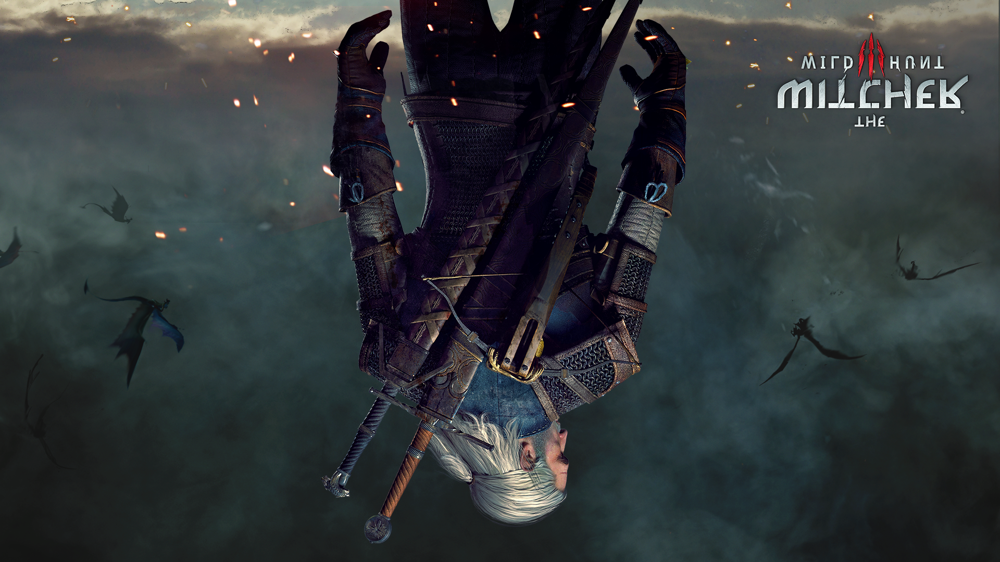

In [ ]:
flipped = flip(img, 0)
cv2_imshow(flipped)

# Implement image translation using Numpy and OpenCV.

In [ ]:
def translate_image(img, dx, dy):
    '''
    Parameters:
    image (numpy.ndarray): The input image as a NumPy array.
    dx (int): The translation amount in the x-direction. Positive values translate to the right.
    dy (int): The translation amount in the y-direction. Positive values translate down

    Returns:
    numpy.ndarray: The translated image as a NumPy array.
    '''

    # YOUR CODE HERE

    #Usando openCV

    (h, w) = img.shape[:2]
    translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])
    translated_image = cv2.warpAffine(img, translation_matrix, (w, h))


    return translated_image

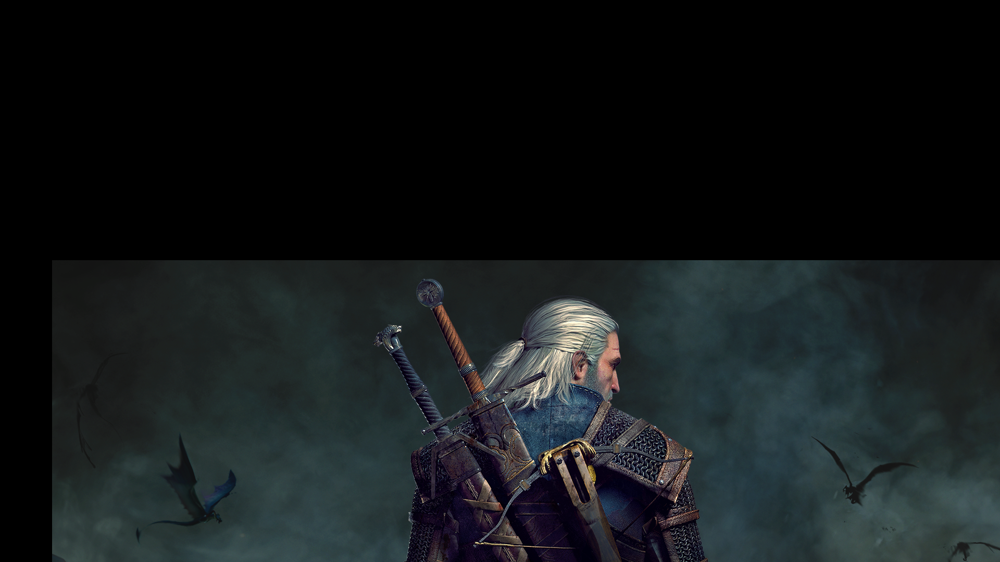

In [ ]:
translated = translate_image(img, 100, 500)
cv2_imshow(translated)

# Implement image rotation around its center using NumPy and OpenCV.

In [ ]:
def rotate_image(img, angle):
    """
    Rotate an image using NumPy and OpenCV.

    Parameters:
    image (numpy.ndarray): The input image as a NumPy array.
    angle (float): The rotation angle in degrees.

    Returns:
    numpy.ndarray: The rotated image as a NumPy array.
    """

    # YOUR CODE HERE
    (height, width) = img.shape[:2]
    center = (height // 2, width // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated_image = cv2.warpAffine(img, rotation_matrix, (width, height))
    return rotated_image

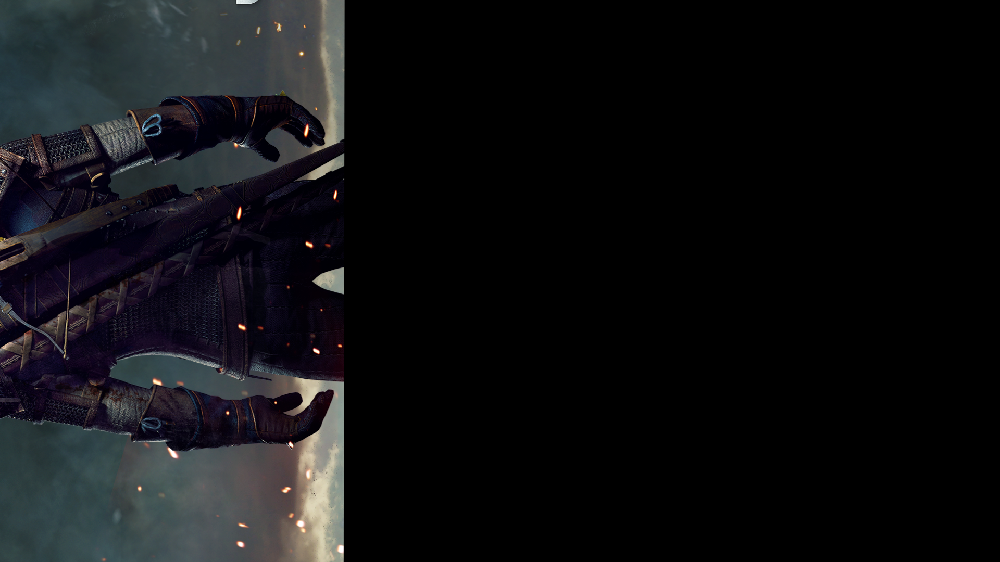

In [ ]:
rotate = rotate_image(img, 89.9)
cv2_imshow(rotate)

# Implement image resizing using OpenCV.

In [ ]:
def resize_image(image, scale):
    """
    Resize an image using OpenCV.

    Parameters:
    image (numpy.ndarray): The input image as a NumPy array.
    scale (float): The scaling factor to resize the image.

    Returns:
    numpy.ndarray: The resized image as a NumPy array.
    """
    #Make sure your scale is greather than zero.
    # YOUR CODE HERE
    new_width = int(image.shape[1] * scale)
    new_height = int(image.shape[0] * scale)

    x, y = np.meshgrid(np.arange(new_width), np.arange(new_height))

    x_scaled = x // scale
    y_scaled = y // scale

    resized_image = image[y_scaled, x_scaled]
    return resized_image

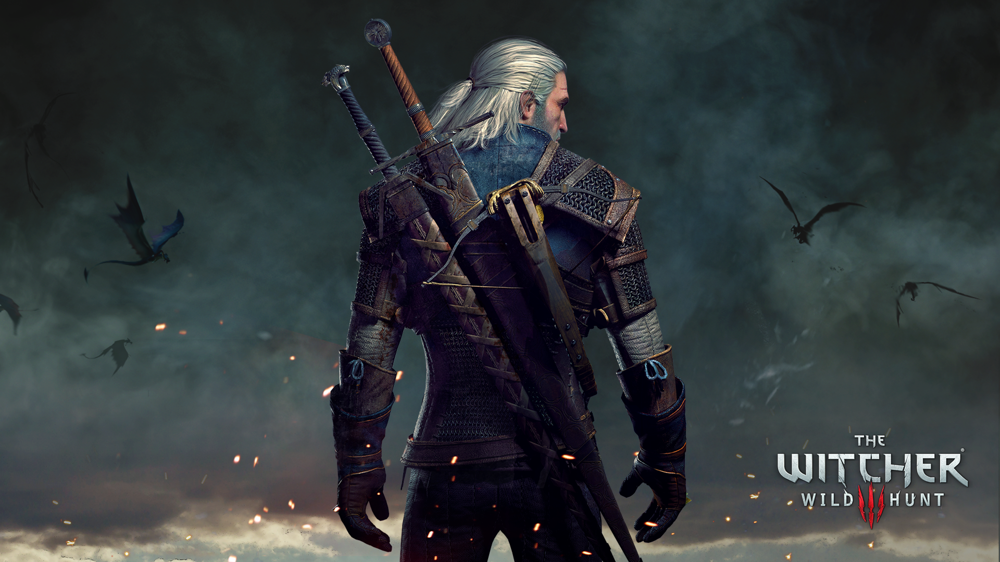

In [ ]:
resize = resize_image(img, 3)
cv2_imshow(resize)

# Implement bitwise operations: AND, OR, XOR.

In [8]:
def bitwise_and(image1, image2):
    """
    Perform a bitwise AND operation on two images using NumPy.

    Parameters:
    image1 (numpy.ndarray): The first input image as a NumPy array.
    image2 (numpy.ndarray): The second input image as a NumPy array.

    Returns:
    numpy.ndarray: The result of the bitwise AND operation as a NumPy array.
    """
    # YOUR CODE HERE
    result = cv2.bitwise_and(image1, image2)
    return result

In [5]:
def bitwise_or(image1, image2):
    """
    Perform a bitwise OR operation on two images using NumPy.

    Parameters:
    image1 (numpy.ndarray): The first input image as a NumPy array.
    image2 (numpy.ndarray): The second input image as a NumPy array.

    Returns:
    numpy.ndarray: The result of the bitwise OR operation as a NumPy array.
    """
    # YOUR CODE HERE
    result = cv2.bitwise_or(image1, image2)
    return result

In [4]:
def bitwise_xor(image1, image2):
    """
    Perform a bitwise XOR (exclusive OR) operation on two images using NumPy.

    Parameters:
    image1 (numpy.ndarray): The first input image as a NumPy array.
    image2 (numpy.ndarray): The second input image as a NumPy array.

    Returns:
    numpy.ndarray: The result of the bitwise XOR operation as a NumPy array.
    """
    # YOUR CODE HERE
    result = cv2.bitwise_xor(image1, image2)
    return result

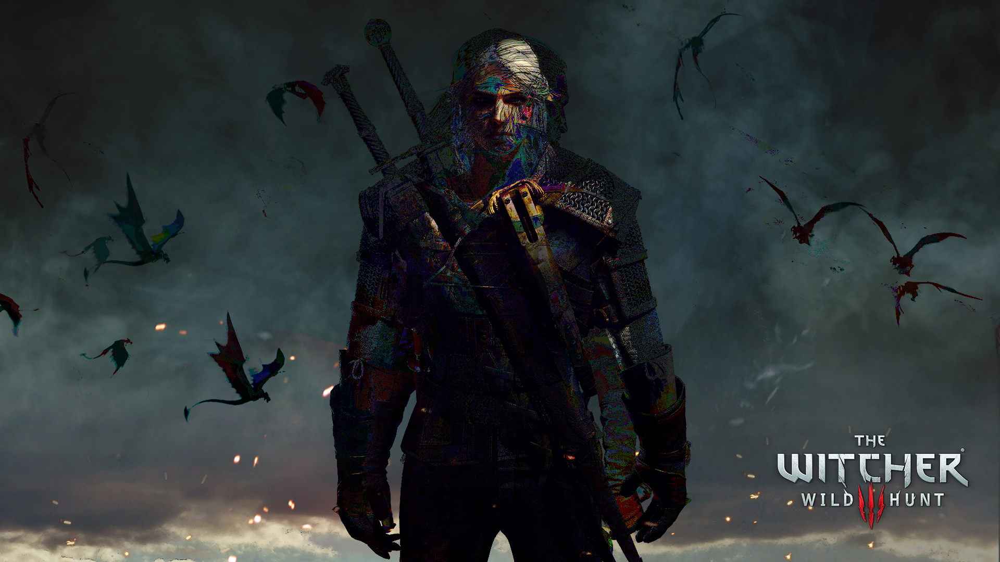

In [ ]:
ande = bitwise_and(200, 25)
cv2_imshow(ande)

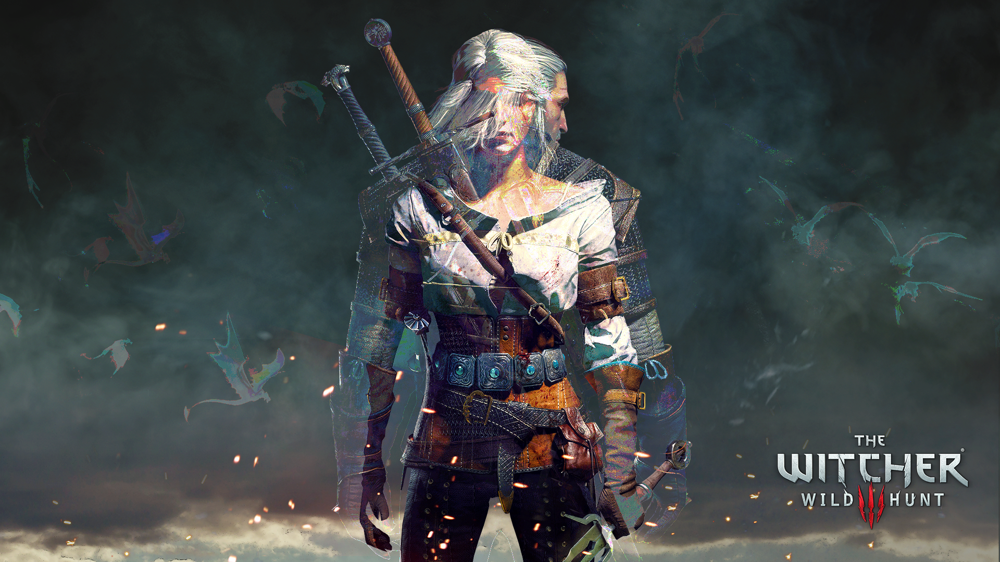

In [ ]:
ou = bitwise_or(200, 25)
cv2_imshow(ou)

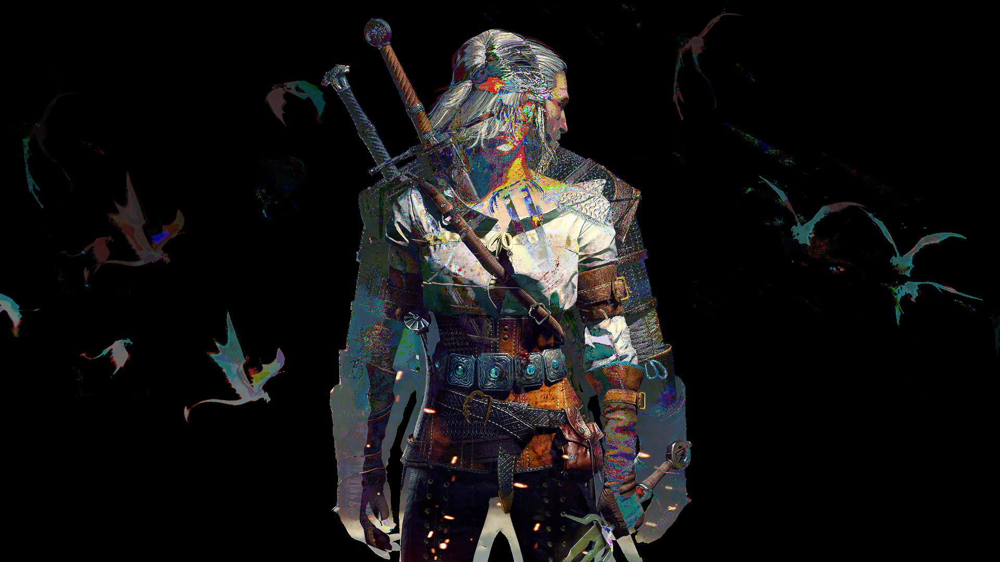

In [ ]:
xor = bitwise_xor(200, 25)
cv2_imshow(xor)

# Implement the "mask" operation, where a third image 'h' contains only a Region of Interest (ROI -- defined by the second image mask 'g') obtained from the input image 'f'. Note that this Region can be of any shape.

Masking is a technique used in Image Processing to isolate and extract the Region of Interest (ROI), which refers to the specific part of an image that is of interest or relevance for analysis.
Bitwise operations are commonly employed for masking as they enable us to selectively retain or discard specific portions of the image. By using bitwise operations, we can efficiently exclude the areas of the image that are not required, focusing only on the desired region for further processing or analysis.

Masking involves three steps:
* Creating a black mask canvas with the same dimensions as the original image.
* Modifying the mask by drawing a shape or figure of interest in white color.
* Applying the bitwise OR operation to combine the modified mask with the original image.

These steps enable us to selectively include or exclude specific regions of the image based on the defined mask.

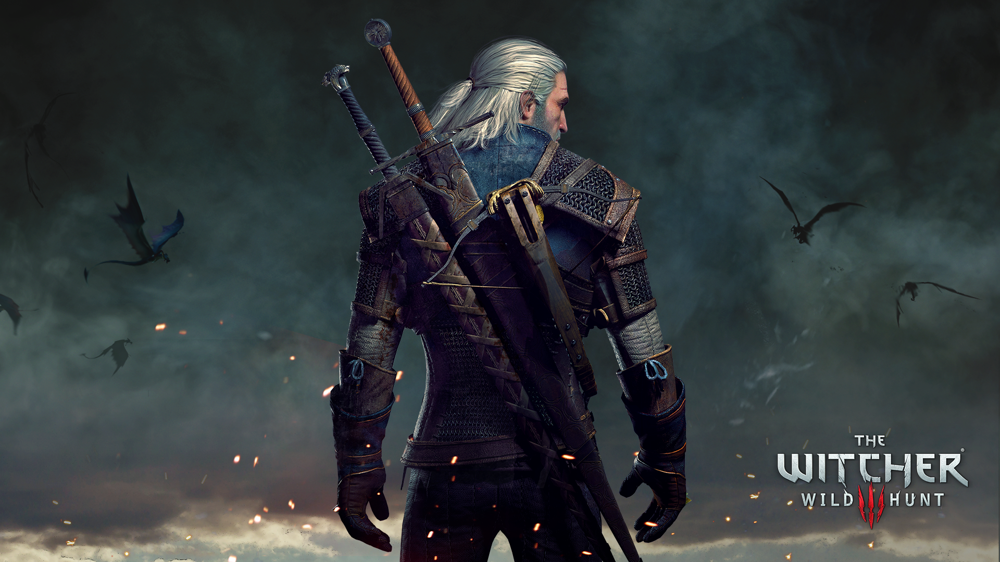

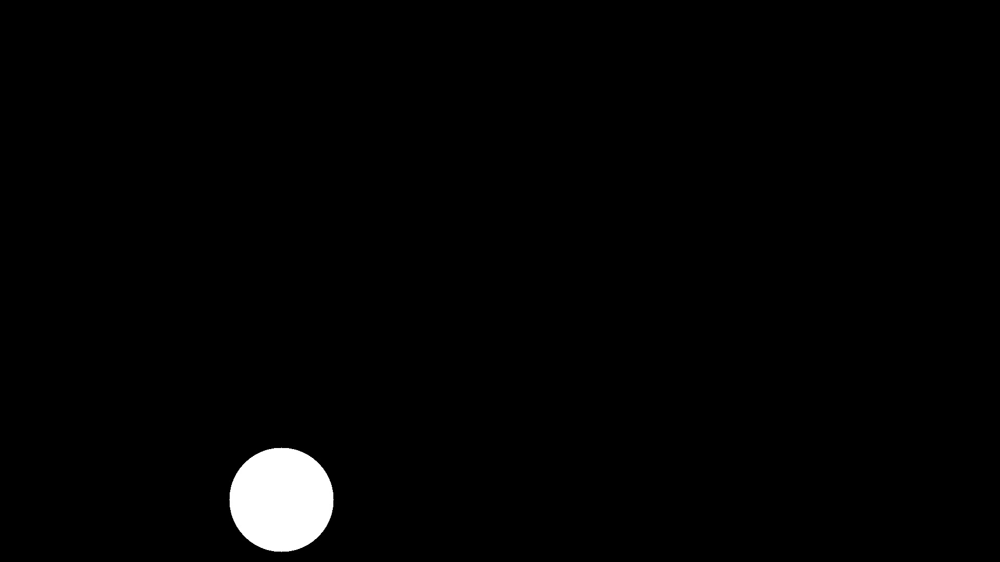

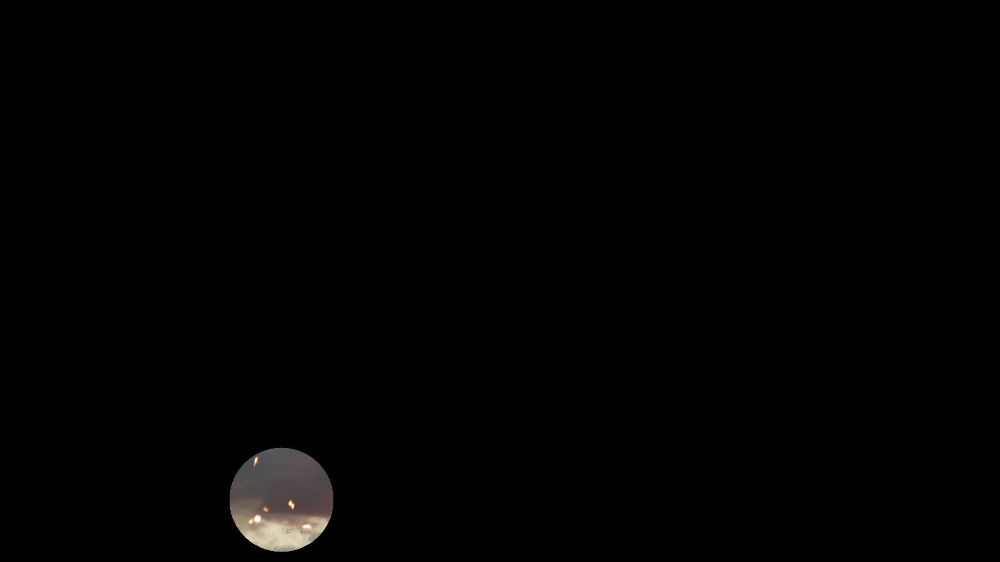

In [19]:
# create a mask of that has the same dimensions of the image
# where each pixel is valued at 0
mask = None

# create a circle on the mask
# where the pixels are valued at 255
x, y = None, None
radius = None
cv2.circle(mask, (x, y), radius, 255, -1)

# perform a bitwise_and with the image and the mask
masked = None


# YOUR CODE HERE
img = cv2.imread('./imagens/img.png', cv2.IMREAD_COLOR)

(h, w) = img.shape[:2]
mask = np.zeros(img.shape, dtype=np.uint8)

x, y = h // 2, w // 2
radius = 100
cv2.circle(mask, (x, y), radius, [255, 255, 255], -1)

masked = bitwise_and(img, mask)


cv2_imshow(img)
cv2_imshow(mask)
cv2_imshow(masked)

cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
_